## 初めに

Kaggle初心者の練習なので、何卒お手柔らかにお願いいたします。

## Setup

In [53]:
import os
os.chdir('C:\\Users\\Takanori\\Desktop\\Kaggle\\TPS2205\\input')

"""
!pip install --user pycaret-nightly -full
!pip install --user autoviz
!pip install --user shap
"""

'\n!pip install --user pycaret-nightly -full\n!pip install --user autoviz\n!pip install --user shap\n'

In [54]:
import numpy as np
import pandas as pd
import numpy as np
import warnings
import pycaret.classification as cf

In [55]:
warnings.simplefilter('ignore')
%matplotlib inline

In [56]:
# データセット読み込み
train = pd.read_csv("../input/tabular-playground-series-may-2022/train.csv")
test = pd.read_csv("../input/tabular-playground-series-may-2022/test.csv")
sub = pd.read_csv("../input/tabular-playground-series-may-2022/sample_submission.csv")
display(train.head())
display(test.head())
display(sub.head())

,id,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,...,f_22,f_23,f_24,f_25,f_26,f_27,f_28,f_29,f_30,target
0,0,-1.373246,0.238887,-0.243376,0.567405,-0.647715,0.839326,0.113133,1,5,...,-2.540739,0.766952,-2.730628,-0.208177,1.363402,ABABDADBAB,67.609153,0,0,0
1,1,1.697021,-1.710322,-2.230332,-0.545661,1.113173,-1.552175,0.447825,1,3,...,2.278315,-0.633658,-1.217077,-3.782194,-0.058316,ACACCADCEB,377.096415,0,0,1
2,2,1.681726,0.616746,-1.027689,0.810492,-0.609086,0.113965,-0.708660,1,0,...,-1.385775,-0.520558,-0.009121,2.788536,-3.703488,AAAEABCKAD,-195.599702,0,2,1
3,3,-0.118172,-0.587835,-0.804638,2.086822,0.371005,-0.128831,-0.282575,3,2,...,0.572594,-1.653213,1.686035,-2.533098,-0.608601,BDBBAACBCB,210.826205,0,0,1
4,4,1.148481,-0.176567,-0.664871,-1.101343,0.467875,0.500117,0.407515,3,3,...,-3.912929,-1.430366,2.127649,-3.306784,4.371371,BDBCBBCHFE,-217.211798,0,1,1


,id,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,...,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28,f_29,f_30
0,900000,0.442517,0.174380,-0.999816,0.762741,0.186778,-1.074775,0.501888,6,6,...,-1.006400,-1.193879,-2.435736,-2.427430,-1.966887,5.734205,BAAABADLAC,99.478419,0,0
1,900001,-0.605598,-0.305715,0.627667,-0.578898,-1.750931,1.355550,-0.190911,1,3,...,2.382405,0.149442,1.883322,-2.848714,-0.725155,3.194219,AFABBAEGCB,-65.993825,1,0
2,900002,0.303990,2.445110,0.246515,0.818248,0.359731,-1.331845,1.358622,3,3,...,-7.026098,1.312277,-5.157192,1.714005,0.585032,0.066898,BBACABBKEE,-87.405622,0,1
3,900003,0.154053,0.260126,-1.367092,-0.093175,-1.111034,-0.948481,1.119220,0,0,...,-0.594532,-3.939475,1.754570,-2.364007,-1.003320,3.893099,AEBEAACQCC,-281.293460,0,0
4,900004,-1.651904,-0.424266,-0.667356,-0.322124,-0.089462,0.181705,1.784983,2,2,...,0.084906,-0.985736,-0.130467,-3.557893,1.210687,1.861884,AEBBBBDABF,25.629415,0,2


,id,target
0,900000,0.5
1,900001,0.5
2,900002,0.5
3,900003,0.5
4,900004,0.5


In [57]:
# 欠損値の確認
display(train.isna().sum())

id        0
f_00      0
f_01      0
f_02      0
f_03      0
f_04      0
f_05      0
f_06      0
f_07      0
f_08      0
f_09      0
f_10      0
f_11      0
f_12      0
f_13      0
f_14      0
f_15      0
f_16      0
f_17      0
f_18      0
f_19      0
f_20      0
f_21      0
f_22      0
f_23      0
f_24      0
f_25      0
f_26      0
f_27      0
f_28      0
f_29      0
f_30      0
target    0
dtype: int64

In [58]:
# f_27が文字列、それ以外は数値
train.dtypes

id          int64
f_00      float64
f_01      float64
f_02      float64
f_03      float64
f_04      float64
f_05      float64
f_06      float64
f_07        int64
f_08        int64
f_09        int64
f_10        int64
f_11        int64
f_12        int64
f_13        int64
f_14        int64
f_15        int64
f_16        int64
f_17        int64
f_18        int64
f_19      float64
f_20      float64
f_21      float64
f_22      float64
f_23      float64
f_24      float64
f_25      float64
f_26      float64
f_27       object
f_28      float64
f_29        int64
f_30        int64
target      int64
dtype: object

In [59]:
# カーディナリィが高いカテゴリ変数、f_27が混ざっており、このままだとメモリ不足する。
# また、整数値のうちカテゴリ変数は29, 30のみであり、7～18は数値として扱うべきである。
train.nunique()

id        900000
f_00      900000
f_01      900000
f_02      900000
f_03      900000
f_04      900000
f_05      900000
f_06      900000
f_07          16
f_08          16
f_09          15
f_10          15
f_11          14
f_12          16
f_13          13
f_14          14
f_15          15
f_16          16
f_17          14
f_18          14
f_19      900000
f_20      900000
f_21      900000
f_22      900000
f_23      900000
f_24      900000
f_25      900000
f_26      900000
f_27      741354
f_28      900000
f_29           2
f_30           3
target         2
dtype: int64

In [60]:
train = train.drop('f_27', axis=1)
test = test.drop('f_27', axis=1)

In [61]:
train = train.sample(frac=1).reset_index(drop=True)

In [62]:
# PyCaretで分析開始
# 初期化
cf1 = cf.setup(train,
               preprocess=False,
               target = 'target',
               use_gpu = True,
               session_id = 123,
               silent = True
              )

,Description,Value
0,session_id,123
1,Target,target
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(900000, 32)"
5,Missing Values,False
6,Numeric Features,17
7,Categorical Features,14
8,Transformed Train Set,"(629999, 30)"
9,Transformed Test Set,"(270001, 30)"


In [63]:
# SetUpで補正後のデータ
cf.get_config('X').head()

,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,f_09,...,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_28,f_29,f_30
0,-0.817341,0.128040,0.031816,1.417969,-0.372176,0.859538,-0.250663,1,3,2,...,-3.649816,0.450133,-3.999269,1.897023,-3.344152,-0.017657,-2.015031,470.765778,1,2
1,1.011389,-0.088070,0.618040,-0.051723,0.377126,0.477136,-0.255994,4,4,1,...,-0.139804,1.923897,1.090965,1.778979,-0.568513,5.500753,1.186427,-139.040634,0,1
2,-0.547947,0.809305,-2.541910,0.542816,0.748855,-1.529618,1.027088,3,3,1,...,-3.506013,-0.917274,1.025450,-4.360167,-1.442108,0.792378,-2.817903,362.439423,0,1
3,0.042520,0.226030,-1.232094,-2.202831,-0.103593,-1.091196,2.898272,1,1,2,...,2.760956,6.789359,-1.595787,-2.936102,-2.385064,1.818576,0.642884,-472.964355,0,1
4,1.979204,-1.037423,0.911107,0.563023,-0.125079,-1.186379,-0.969888,4,2,2,...,-3.034534,0.640514,-2.980141,0.027742,-1.557179,0.539244,0.081083,212.941513,0,1


In [64]:
import matplotlib.pyplot as plt

In [65]:
from matplotlib.colors import ListedColormap

In [72]:
smp_train = train.sample(frac=1).reset_index(drop=True)[:100000]

In [73]:
smp_train.drop('id', axis=1, inplace=True)

In [74]:
int_features = []
for col in smp_train.columns:
    if smp_train[col].dtype == 'int64' and col != 'target':
        int_features.append(col)
smp_train.drop(int_features, axis=1, inplace=True)

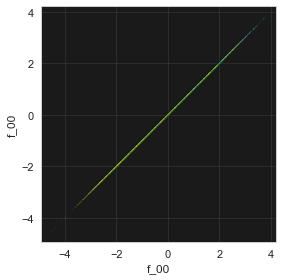

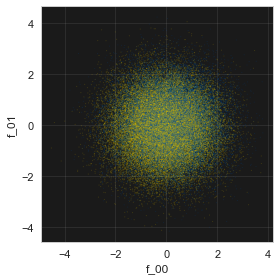

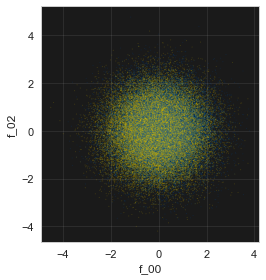

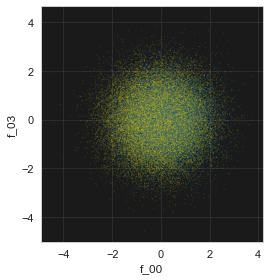

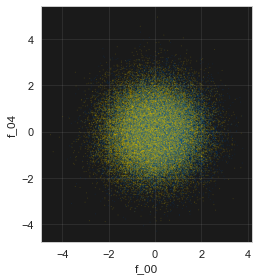

...

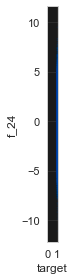

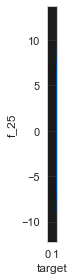

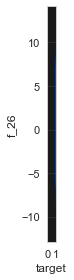

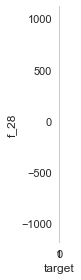

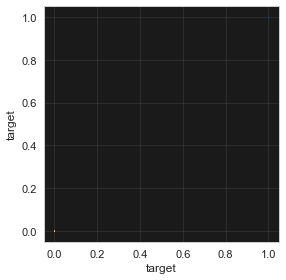

In [77]:
plt.rcParams['axes.facecolor'] = 'k'

cmap = ListedColormap(["#ffd700", "#0057b8"])

for col1 in smp_train.columns:
    for col2 in smp_train.columns:
        fig = plt.figure()
        ax = fig.add_subplot(111)
        ax.scatter(smp_train[col1], smp_train[col2], s=2, c=smp_train['target'], cmap=cmap, alpha=0.1)
        ax.set_xlabel(col1)
        ax.set_ylabel(col2)
        ax.set_aspect('equal')
        plt.tight_layout(w_pad=0.5, h_pad=0.5)
        plt.show()

plt.rcParams['axes.facecolor'] = '#0057b8' # blue

    Since nrows is smaller than dataset, loading random sample of 100000 rows into pandas...
Shape of your Data Set loaded: (100000, 32)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    31 Predictors classified...
        1 variables removed since they were ID or low-information variables
Since Number of Rows in data 100000 exceeds maximum, randomly sampling 100000 rows for EDA...

################ Binary_Classification VISUALIZATION Started #####################


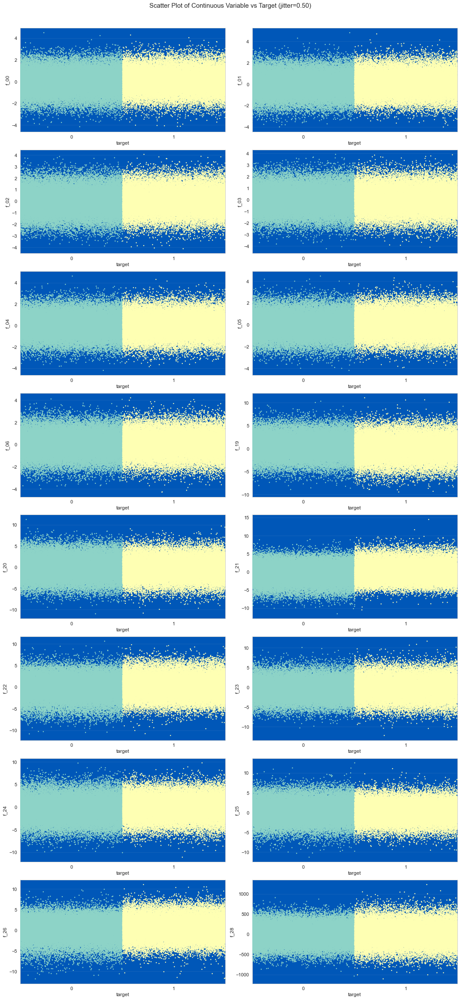

Total Number of Scatter Plots = 136


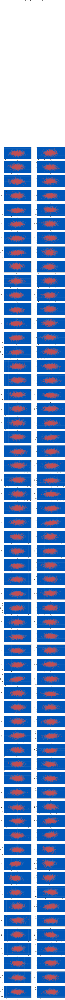

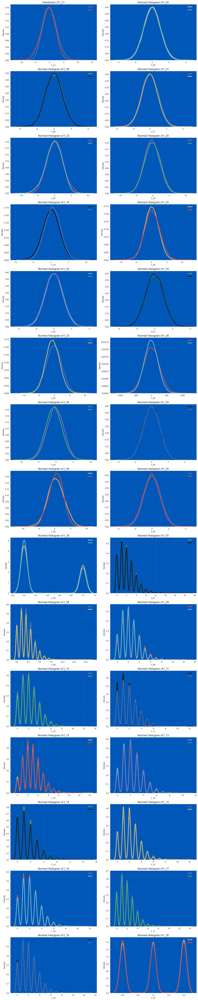

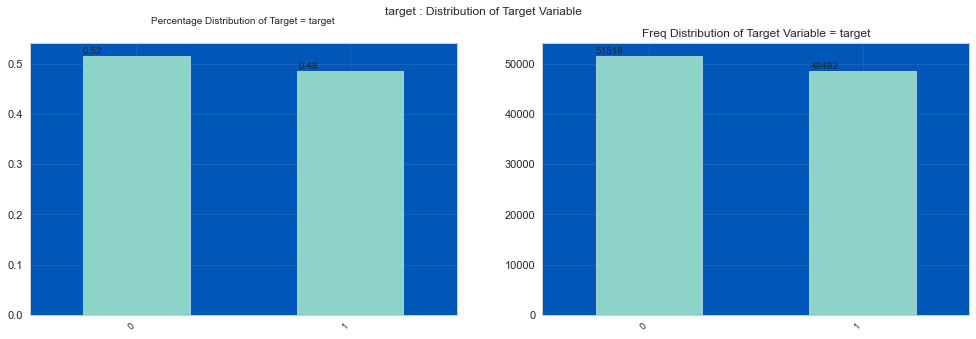

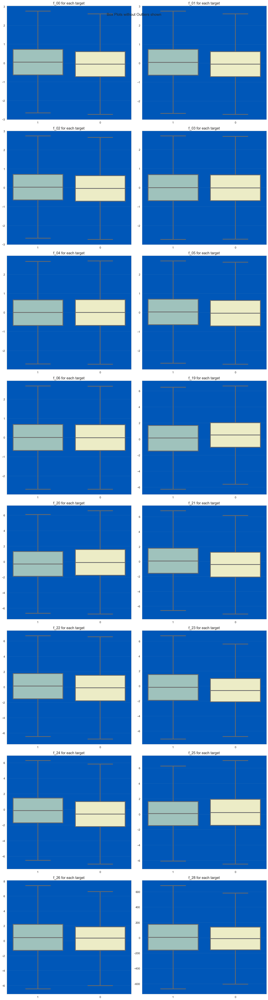

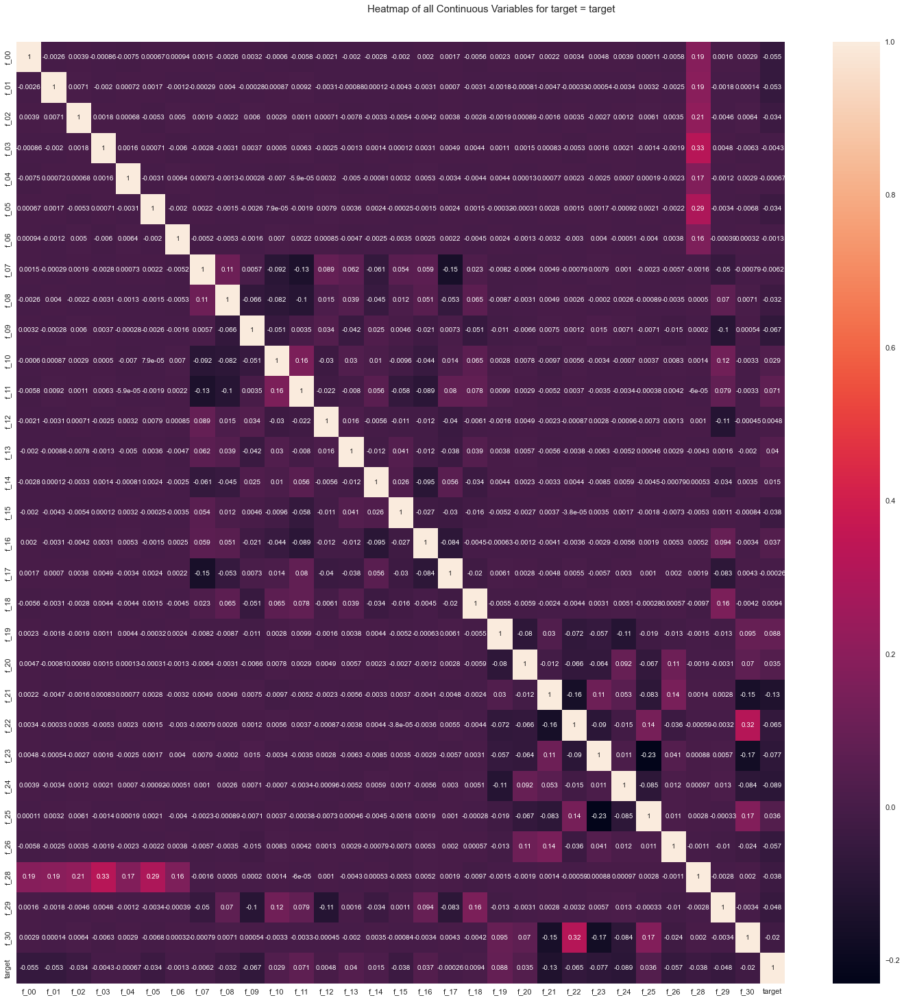

Could not draw Pivot Charts against Dependent Variable


<Figure size 1440x16740 with 0 Axes>

Time to run AutoViz = 161 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


In [45]:
# 探査的データ分析
%matplotlib inline
import matplotlib as mpl
mpl.rcParams['lines.markersize'] = 1
mpl.rcParams['scatter.marker']='.'
plt.rcParams['axes.facecolor'] = 'k'
#cf.eda(display_format='svg', max_rows_analyzed=10000)
# cf.eda(display_format='svg', max_rows_analyzed=1000, target='target',)
cf.eda(display_format='svg', max_rows_analyzed=100000, max_cols_analyzed=100)

In [11]:
model = cf.create_model('lightgbm')

IntProgress(value=0, description='Processing: ', max=4)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,23:51:26
Status,. . . . . . . . . . . . . . . . . .,Fitting 10 Folds
Estimator,. . . . . . . . . . . . . . . . . .,Light Gradient Boosting Machine


,Fold,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC


KeyboardInterrupt: 

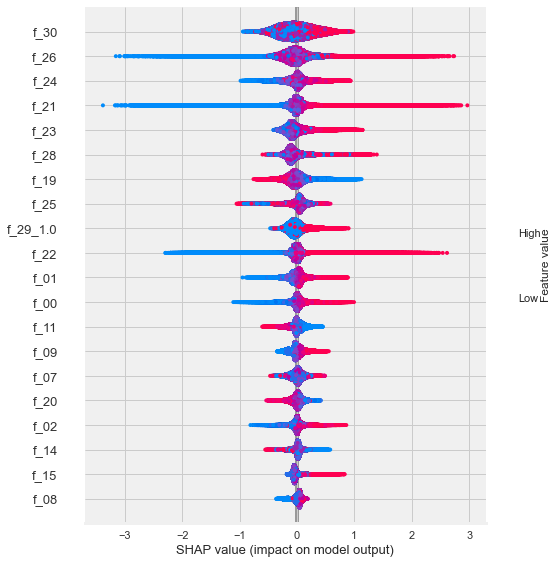

In [ ]:
%matplotlib inline
cf.interpret_model(model)

In [ ]:
pred =cf.predict_model(model, data=test, raw_score=True)
pred.head()

,id,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,...,f_23,f_24,f_25,f_26,f_28,f_29,f_30,Label,Score_0.0,Score_1.0
0,900000.0,0.442517,0.174380,-0.999816,0.762741,0.186778,-1.074775,0.501888,6.0,6.0,...,-2.435736,-2.427430,-1.966887,5.734205,99.478419,0.0,0.0,1.0,0.2240,0.7760
1,900001.0,-0.605598,-0.305715,0.627667,-0.578898,-1.750931,1.355550,-0.190911,1.0,3.0,...,1.883322,-2.848714,-0.725155,3.194219,-65.993825,1.0,0.0,1.0,0.3699,0.6301
2,900002.0,0.303990,2.445110,0.246515,0.818248,0.359731,-1.331845,1.358622,3.0,3.0,...,-5.157192,1.714005,0.585032,0.066898,-87.405622,0.0,1.0,0.0,0.8940,0.1060
3,900003.0,0.154053,0.260126,-1.367092,-0.093175,-1.111034,-0.948481,1.119220,0.0,0.0,...,1.754570,-2.364007,-1.003320,3.893099,-281.293460,0.0,0.0,0.0,0.7853,0.2147
4,900004.0,-1.651904,-0.424266,-0.667356,-0.322124,-0.089462,0.181705,1.784983,2.0,2.0,...,-0.130467,-3.557893,1.210687,1.861884,25.629415,0.0,2.0,1.0,0.3693,0.6307


In [ ]:
sub['target'] = pred.reset_index()['Score_1']
sub.to_csv('submission.csv', index=False)
sub

KeyError: 'Score_1'

In [ ]:
cf.evaluate_model(model)